Dataset is available at this link: https://www.kaggle.com/datasets/giannisgeorgiou/fish-species

# Imports

In [28]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

import random as rnd
from PIL import Image

import cv2
from skimage.filters import sobel
from skimage import color

from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from numpy import expand_dims


from keras import layers
import keras.backend as K
from keras.models import Sequential, Model
from keras.preprocessing import image
from keras.layers import Input, Dense, Activation, Dropout
from keras.layers import Flatten, BatchNormalization
from keras.layers import Convolution2D, MaxPooling2D, AveragePooling2D, GlobalAveragePooling2D 
from tensorflow.keras.applications import MobileNetV2
sns.set_style('darkgrid')

import itertools
import os

For GPU usage:

In [2]:
# !pip install tensorflow-gpu

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 578.0/578.0 MB 2.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.4/123.4 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 62.6 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 22.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.7/438.7 kB 23.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 53.4 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.6.0
    Uninstalling keras-2.6.0:
      Successfully uninstalled keras-2.6.0
  Attempting uninstall: flatbuffers
    Found existing installation: flatbuffers 1.12
    Uninstalling flatbuffers-1.12:
      Successfully uninstalled flatbuffers-1.12
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninst

# Loading Dataset

In [3]:
train_df = pd.DataFrame()

In [4]:
classes = []
paths = []

dirs = ['../input/fish-species/Species/Training_Set/'+ species_name for species_name in os.listdir('../input/fish-species/Species/Training_Set')]

for image_dir in dirs:
    for image in os.listdir(image_dir):
        class_ = image_dir.split('/')[5]
        classes.append(class_)
        paths.append(image_dir+'/'+image)

In [5]:
train_df['Label'] = classes
train_df['Filepath'] = paths

In [42]:
train_df.head(100)

,Label,Filepath
0,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
1,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
2,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
3,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
4,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
...,...,...
95,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
96,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
97,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...
98,Polyprion americanus,../input/fish-species/Species/Training_Set/Pol...


In [6]:
train_df.count()

Label       34000
Filepath    34000
dtype: int64

In [43]:
print('Train images count: ', len(train_df))

Train images count:  34000


In [44]:
print('All class count: ',len(train_df['Label'].value_counts())) # all classes count
train_df['Label'].unique() # all classes

All class count:  20


array(['Polyprion americanus', 'Scomber japonicus',
       'Trigloporus lastoviza', 'Dasyatis centroura',
       'Tetrapturus belone', 'Anthias anthias', 'Coris julis',
       'Solea solea', 'Boops boops', 'Chlorophthalmus agassizi',
       'Squalus acanthias', 'Trachinus draco', 'Pseudocaranx dentex',
       'Belone belone', 'Gobius niger', 'Mugil cephalus', 'Phycis phycis',
       'Atherinomorus lacunosus', 'Rhinobatos cemiculus',
       'Epinephelus caninus'], dtype=object)

# Checking missing data

In [7]:
train_df.isna().sum()

Label       0
Filepath    0
dtype: int64

# Visualization

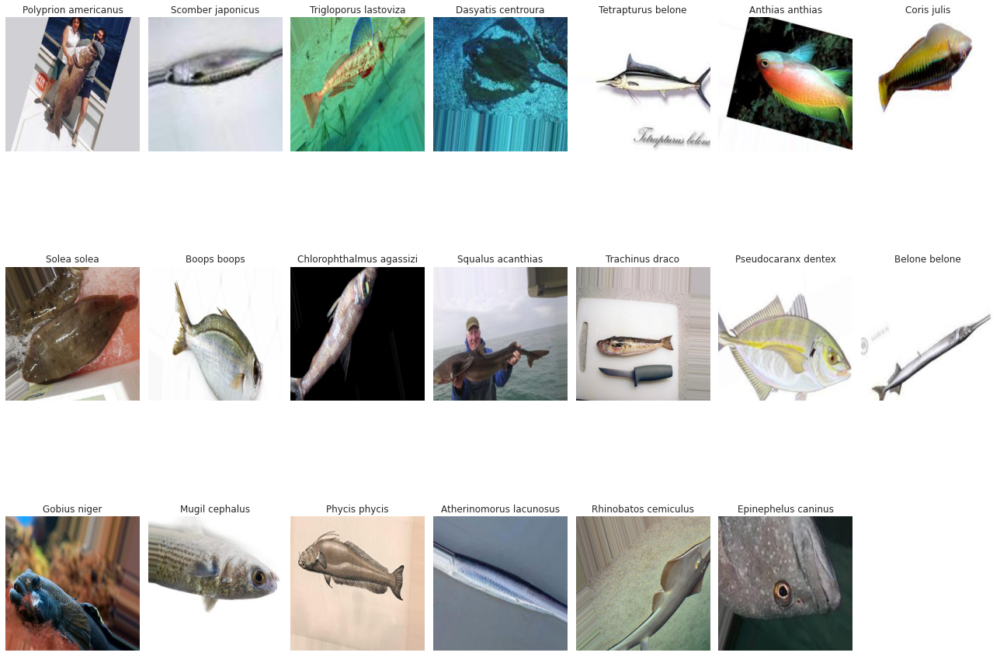

In [46]:
plt.figure(figsize = (18,18))

for index,i in enumerate(train_df.Label.unique()):
    plt.subplot(4,7,index+1)
    dataFrame = train_df[train_df['Label'] ==i].reset_index(drop = True)
    image_Filepath = dataFrame.loc[rnd.randint(0, len(dataFrame))-1,'Filepath'] # filepath
    img = Image.open(image_Filepath)  # open the image
    img = img.resize((224,224)) # Resizing to 224x224
    plt.imshow(img)
    plt.axis('off')
    plt.title(i)
    
plt.tight_layout()
plt.show()

In [9]:
def plot_species(dataFrame,class_name): # function to plot images with species (text)
    plt.figure(figsize = (18,18))
    classes_dataFrame = train_df[train_df['Label'] ==  class_name].reset_index(drop = True)
    plt.suptitle(class_name)
    for idx,i in enumerate(np.random.choice(classes_dataFrame['Filepath'],8)):
        plt.subplot(8,8,idx+1)
        image_Filepath = i
        img = Image.open(image_Filepath)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

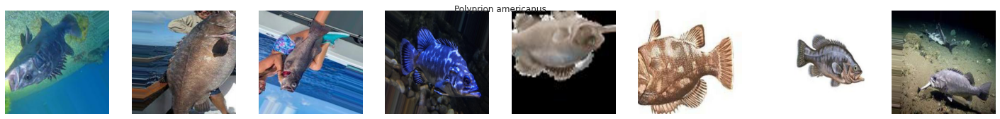

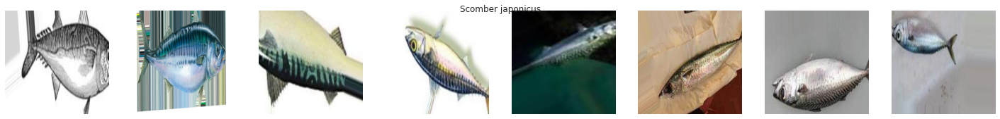

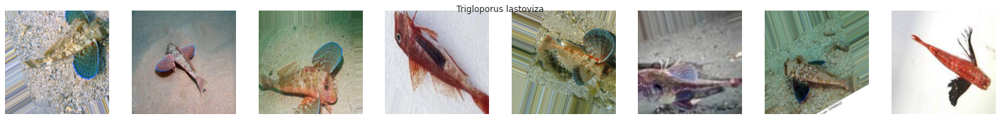

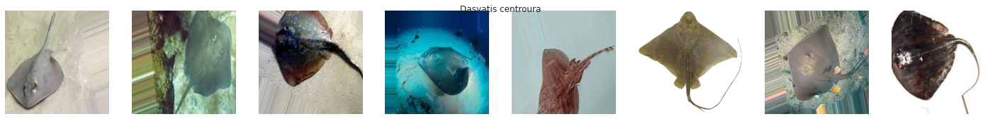

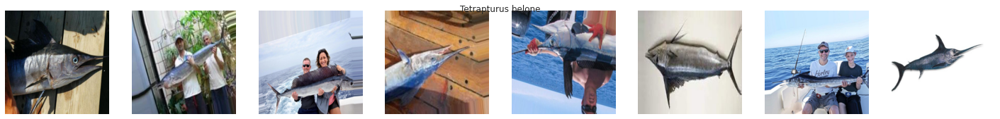

...

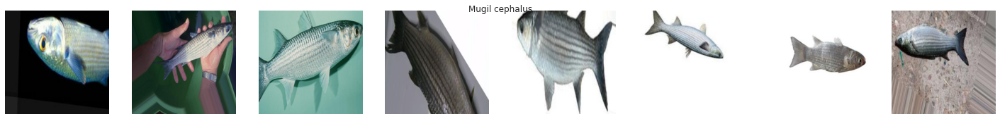

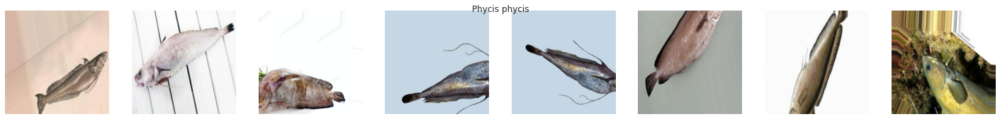

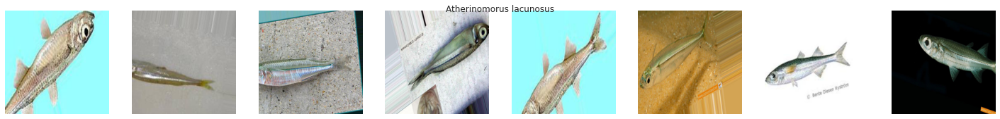

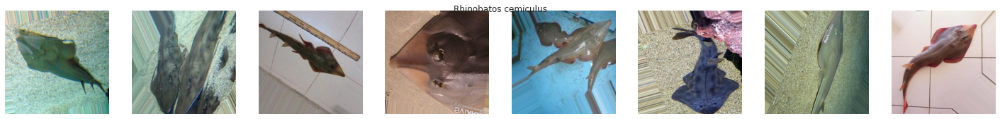

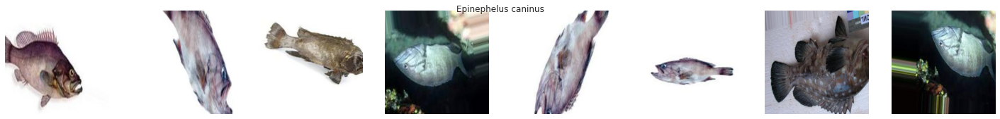

In [10]:
for class in train_df['Label'].unique():
    plot_species(train_df , class)

# Class Distribution Analysis

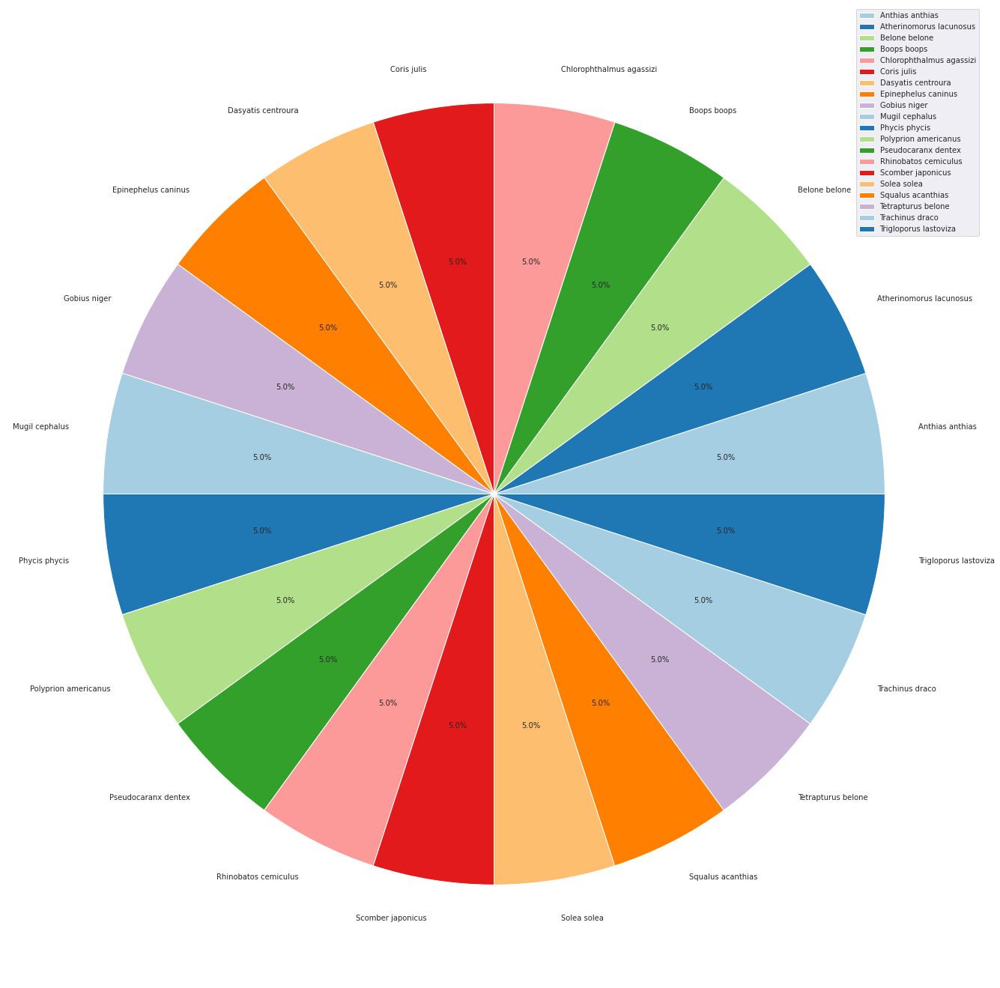

In [49]:
plt.figure(figsize=(24,24))
class_count = train_df.groupby(['Label']).size().reset_index(name = 'counts')
colors = sns.color_palette('Paired')[0:9]
plt.pie(class_count['counts'], labels=class_count['Label'], colors=colors, autopct='%1.1f%%')
plt.legend(loc='upper right')
plt.show()

# Analyzing features (adds-on)

## Analyzing Edges

A Sobel filter is one means of getting a basic edge magnitude/gradient image. 

Can be useful to threshold and find prominent linear features, etc. 

In [15]:
def edges_images_gray(class_name):
    classes_dataFrame = train_df[train_df['Label'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_dataFrame['Filepath'],2)):
        image = cv2.imread(i) # read image
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # convert
        edges = sobel(image) # sobel function to see edges of images
        gray_edges = sobel(gray)
        dimension = edges.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(gray_edges)
        plt.subplot(2,2,2)
        plt.imshow(edges[:dimension[0],:dimension[1],0], cmap="gray")
        plt.subplot(2,2,3)
        plt.imshow(edges[:dimension[0],:dimension[1],1], cmap='gray')
        plt.subplot(2,2,4)
        plt.imshow(edges[:dimension[0],:dimension[1],2], cmap='gray')
        plt.show()

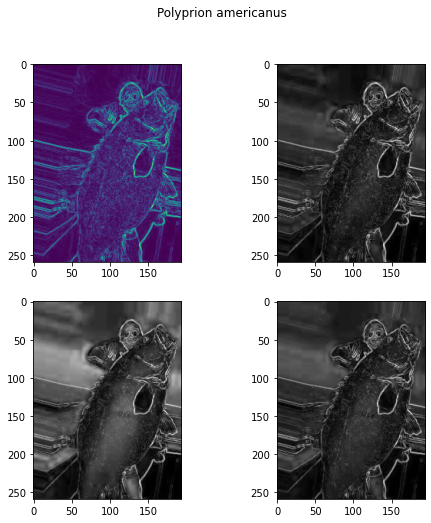

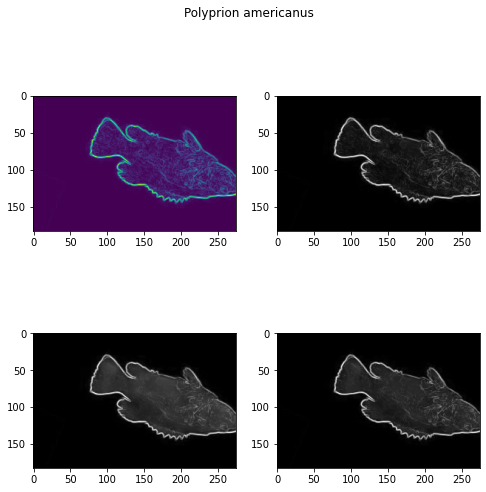

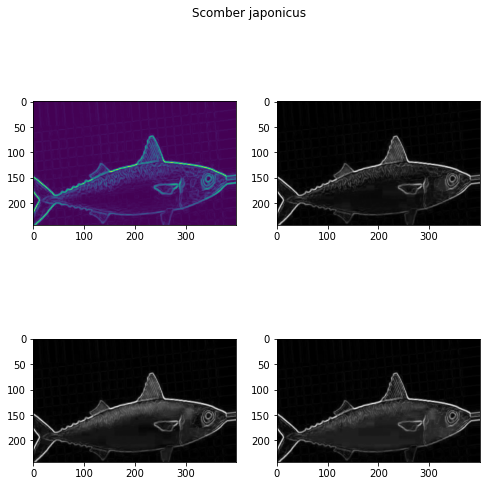

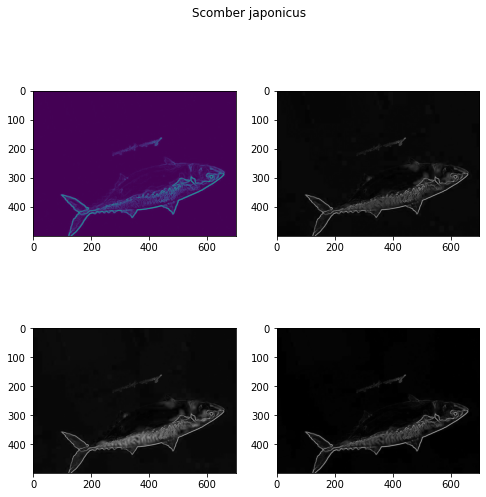

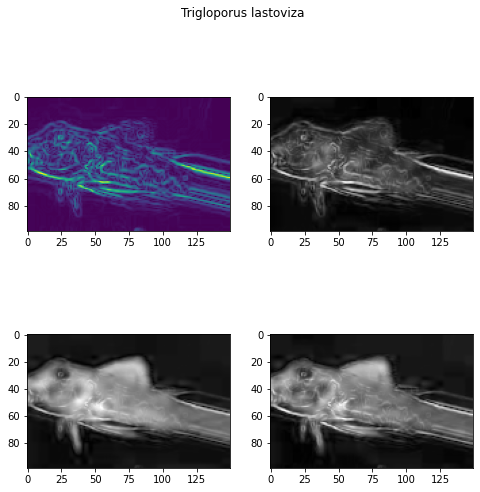

KeyboardInterrupt: 

In [16]:
for class_name in train_df['Label'].unique():
    edges_images_gray(class_name)

## Corners

In [20]:
def corners_images_gray(class_name):
    classes_dataFrame = train_df[train_df['Label'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_dataFrame['Filepath'],4)):
        image = cv2.imread(i) # read image
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # convert
        corners_gray = cv2.goodFeaturesToTrack(gray, maxCorners=50, qualityLevel=0.02, minDistance=20)
        corners_gray = np.float32(corners_gray)
        for item in corners_gray:
            x, y = item[0]
            cv2.circle(image, (int(x), int(y)), 6, (0, 255, 0), -1)
        fig = plt.figure(figsize=(16, 16))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(image, cmap="BuGn")
        plt.show()

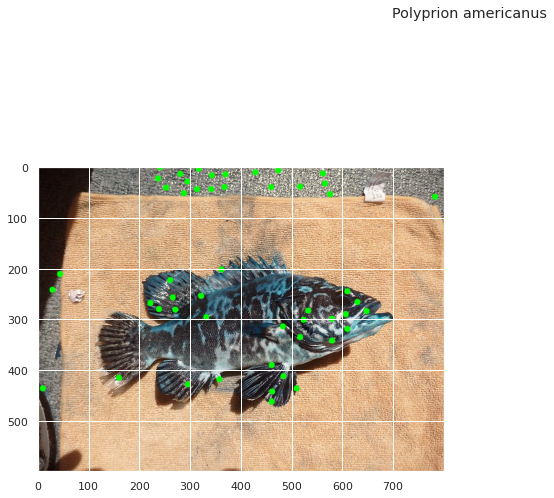

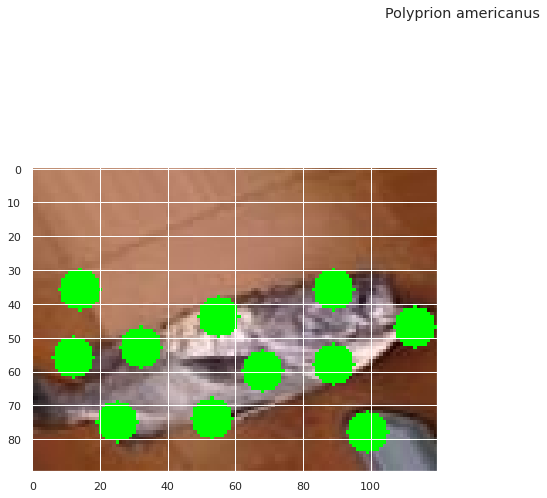

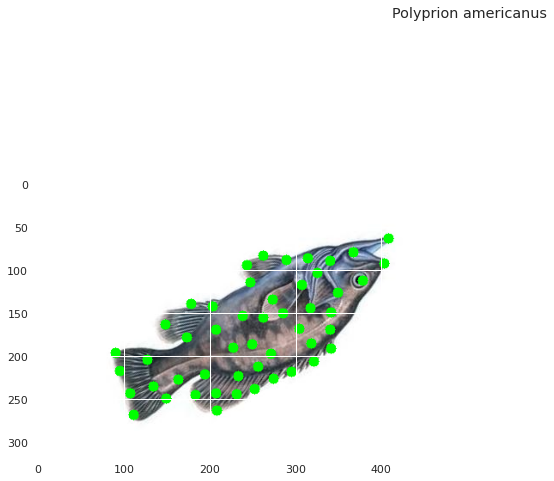

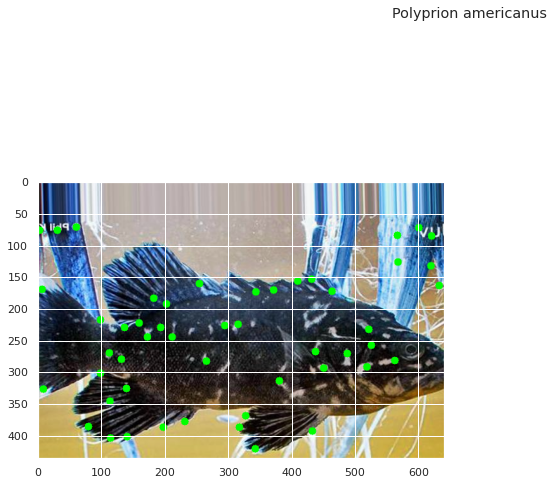

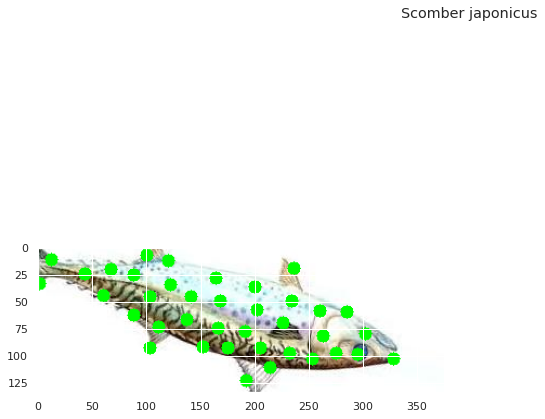

...

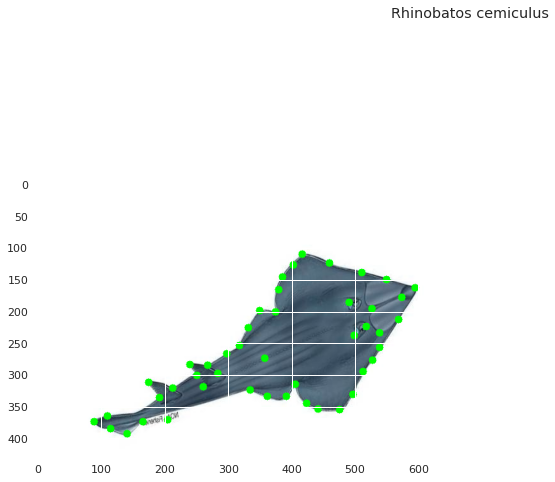

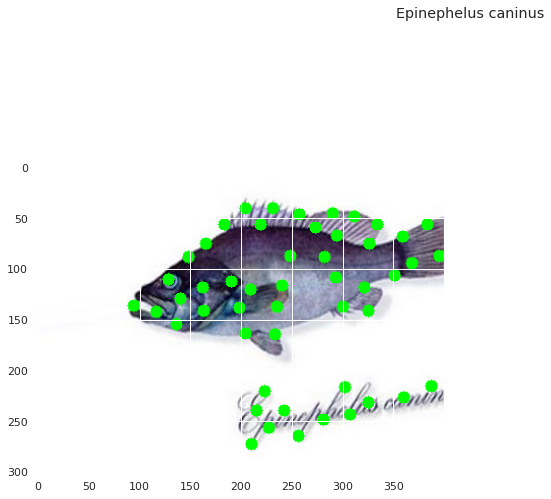

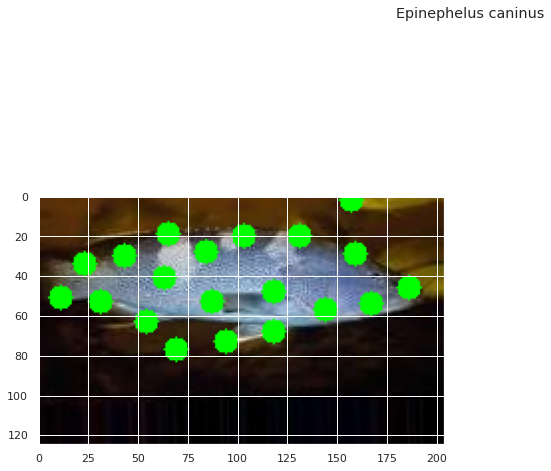

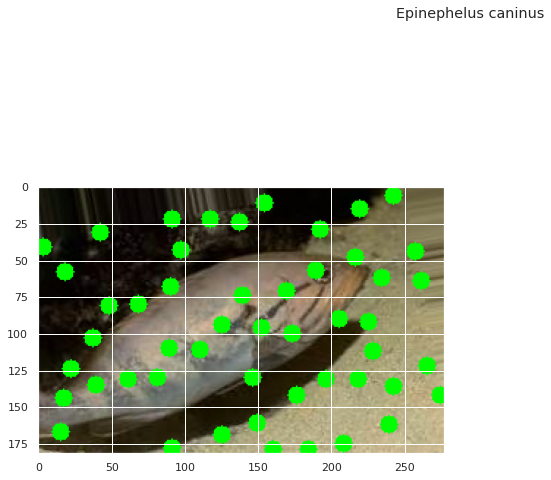

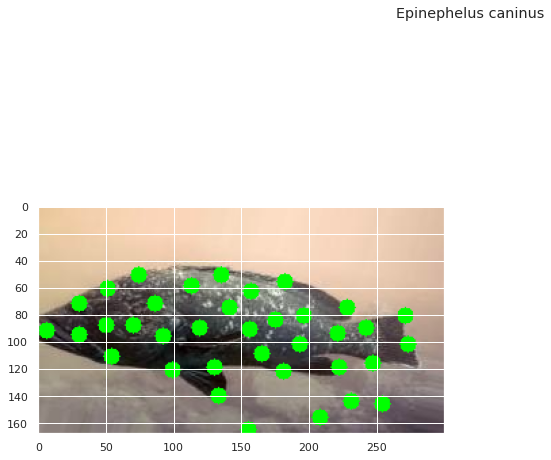

In [21]:
for class_name in train_df['Label'].unique():
    corners_images_gray(class_name)

# Plot Augmentations

In [50]:
def plot_augimages(Filepaths, datagen):
    plt.figure(figsize = (14,28))
    plt.suptitle('Augmented Images')
    
    midx = 0
    for Filepath in Filepaths:
        data = Image.open(Filepath)
        data = data.resize((224,224))
        samples = expand_dims(data, 0)
        it = datagen.flow(samples, batch_size=1)
    
        # Show Original Image
        plt.subplot(10,5, midx+1)
        plt.imshow(data)
        plt.axis('off')
    
        # Show Augmented Images
        for idx, i in enumerate(range(4)):
            midx += 1
            plt.subplot(10,5, midx+1)
            
            batch = it.next()
            image = batch[0].astype('uint8')
            plt.imshow(image)
            plt.axis('off')
        midx += 1
    
    plt.tight_layout()
    plt.show()

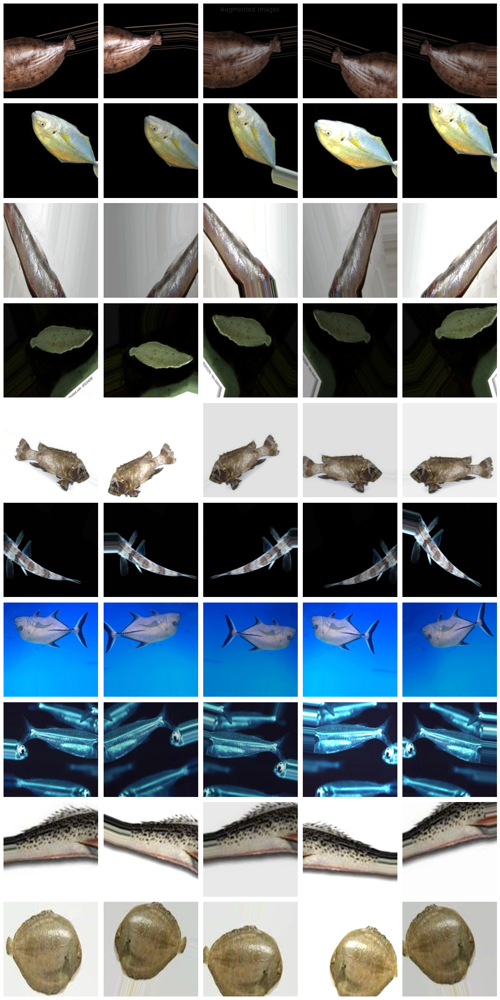

In [51]:
datagen = ImageDataGenerator( # creating data aug 
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
)

plot_augimages(np.random.choice(train_df['Filepath'],10), datagen) # plotting aug images with originals

# Modelling

In [7]:
y_count=len(train_df['Label'].unique())

## MobileNetV2

In [28]:
mobilenetV2 = MobileNetV2(include_top = False, input_shape = (224,224,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in mobilenetV2.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(mobilenetV2.output)
predictions = Dense(y_count, activation='softmax')(x)

model_mobilenetV2 = Model(inputs = mobilenetV2.input, outputs = predictions)

## EfficientNet

In [44]:
from tensorflow.keras.applications import EfficientNetB0

efficientNet = EfficientNetB0(include_top = False, input_shape = (224,224,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in efficientNet.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(efficientNet.output)
x = layers.BatchNormalization()(x)
predictions = Dense(y_count, activation='softmax')(x)

model_efficientNet = Model(inputs = efficientNet.input, outputs = predictions)


16711680/16705208 [==============================] - 0s 0us/step

16719872/16705208 [==============================] - 0s 0us/step


## Custom model

In [94]:
def create_model():
    model = Sequential()

    model.add(Convolution2D(32,(3,3),activation='relu',input_shape=(224, 224, 3)))
    model.add(BatchNormalization())
    model.add(Convolution2D(32,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.3))

    model.add(Convolution2D(32,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization())
    model.add(Convolution2D(32,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.3))

    model.add(Convolution2D(64,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization())
    model.add(Convolution2D(64,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.5))

    model.add(Flatten())
    model.add(Dense(512,activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(0.5))
    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))
    model.add(Dense(20,activation='softmax'))

    return model


custom_model = create_model()

# Compile Model

## MobileNetV2

In [29]:
model_mobilenetV2.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])
rlrp_mobilenetV2 = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.01,patience=2,verbose=2)
mobilenetV2.summary()

Model: "mobilenetv2_1.00_224"

__________________________________________________________________________________________________

Layer (type)                    Output Shape         Param #     Connected to                     


input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            

__________________________________________________________________________________________________

Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_2[0][0]                    

__________________________________________________________________________________________________

bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      

__________________________________________________________________________________________________

Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   

____________________________________________________________________

## EfficientNet

In [45]:
model_efficientNet.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])
rlrp_efficientNet = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.01,patience=2,verbose=2)
efficientNet.summary()

Model: "efficientnetb0"

__________________________________________________________________________________________________

Layer (type)                    Output Shape         Param #     Connected to                     


input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            

__________________________________________________________________________________________________

rescaling (Rescaling)           (None, 224, 224, 3)  0           input_3[0][0]                    

__________________________________________________________________________________________________

normalization (Normalization)   (None, 224, 224, 3)  7           rescaling[0][0]                  

__________________________________________________________________________________________________

stem_conv_pad (ZeroPadding2D)   (None, 225, 225, 3)  0           normalization[0][0]              

__________________________________________________________________________

## Custom model

In [95]:
custom_model.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])
custom_model.summary()

Model: "sequential_3"

_________________________________________________________________

Layer (type)                 Output Shape              Param #   


conv2d_18 (Conv2D)           (None, 222, 222, 32)      896       

_________________________________________________________________

batch_normalization_19 (Batc (None, 222, 222, 32)      128       

_________________________________________________________________

conv2d_19 (Conv2D)           (None, 222, 222, 32)      9248      

_________________________________________________________________

batch_normalization_20 (Batc (None, 222, 222, 32)      128       

_________________________________________________________________

max_pooling2d_9 (MaxPooling2 (None, 111, 111, 32)      0         

_________________________________________________________________

dropout_15 (Dropout)         (None, 111, 111, 32)      0         

_________________________________________________________________

conv2d_20 (Conv2D)           (None, 11

# Train Generators

## MobileNetV2

In [11]:
# image preprocessing function ready for mobileNetV2 specially
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input 

In [12]:
mobilenet_v2_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
)

In [13]:
train_generator_mobilenet_v2 = mobilenet_v2_datagen.flow_from_directory(
        '../input/fish-species/Species/Training_Set',
        target_size=(224, 224),  # All images will be resized to 224x224
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 34000 images belonging to 20 classes.


In [14]:
val_generator_mobilenet_v2 = mobilenet_v2_datagen.flow_from_directory(
        '../input/fish-species/Species/Test_Set',
        target_size=(224, 224),  # All images will be resized to 224x224
        batch_size=32,
        class_mode="categorical",
)

Found 6000 images belonging to 20 classes.


## EfficientNet

In [13]:
train_generator_efficientNet = datagen.flow_from_directory(
        '../input/fish-species/Species/Training_Set',
        target_size=(224, 224),  # All images will be resized to 224x224
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 34000 images belonging to 20 classes.


In [14]:
val_generator_efficientNet = datagen.flow_from_directory(
        '../input/fish-species/Species/Test_Set',
        target_size=(224, 224),  # All images will be resized to 224x224
        batch_size=32,
        class_mode="categorical",
)

Found 6000 images belonging to 20 classes.


## Custom model

In [10]:
train_generator_custom_model =datagen.flow_from_directory(
        '../input/fish-species/Species/Training_Set',
        target_size=(224,224),  # All images will be resized to 64x64
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 34000 images belonging to 20 classes.


In [11]:
val_generator_custom_model = datagen.flow_from_directory(
        '../input/fish-species/Species/Test_Set',
        target_size=(224,224),  # All images will be resized to 64x64
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 6000 images belonging to 20 classes.


**To get fish species instead of numbers. Because when model gives prediction it encodes the labels/ground truth (fish species):**

In [40]:
labels = [None] * len(val_generator_custom_model.class_indices)
for k, v in val_generator_custom_model.class_indices.items():
    labels[v] = k

# Model Fitting

## MobileNetV2

In [34]:
history_mobilenet_v2 = model_mobilenetV2.fit(
      train_generator_mobilenet_v2,
     validation_data=val_generator_mobilenet_v2,
      epochs=10,
      callbacks = [rlrp_mobilenetV2],
      verbose=2)

Epoch 1/10


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

1063/1063 - 759s - loss: 0.7004 - accuracy: 0.7966 - val_loss: 0.4135 - val_accuracy: 0.8702

Epoch 2/10

1063/1063 - 726s - loss: 0.3392 - accuracy: 0.8949 - val_loss: 0.3293 - val_accuracy: 0.8953

Epoch 3/10

1063/1063 - 723s - loss: 0.2747 - accuracy: 0.9138 - val_loss: 0.2639 - val_accura

## EfficientNet

In [50]:
history_efficientNet = model_efficientNet.fit(
      train_generator_efficientNet,
     validation_data=val_generator_efficientNet,
      epochs=10,
      callbacks = [rlrp_efficientNet],
      verbose=2)

Epoch 1/10


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

1063/1063 - 756s - loss: 0.4618 - accuracy: 0.8582 - val_loss: 0.1684 - val_accuracy: 0.9497

Epoch 2/10

1063/1063 - 728s - loss: 0.1943 - accuracy: 0.9374 - val_loss: 0.1253 - val_accuracy: 0.9632

Epoch 3/10

1063/1063 - 727s - loss: 0.1513 - accuracy: 0.9502 - val_loss: 0.1031 - val_accura

## Custom model

In [98]:
history_custom_model = custom_model.fit(
      train_generator_custom_model,
     validation_data=val_generator_custom_model,
#       steps_per_epoch=100,
      epochs=10,
      verbose=2)

Epoch 1/10


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.

Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()

To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

1063/1063 - 738s - loss: 2.7581 - accuracy: 0.1890 - val_loss: 2.3537 - val_accuracy: 0.2558

Epoch 2/10

1063/1063 - 711s - loss: 2.2259 - accuracy: 0.3068 - val_loss: 1.9709 - val_accuracy: 0.3847

Epoch 3/10

1063/1063 - 712s - loss: 1.9706 - accuracy: 0.3765 - val_loss: 2.5064 - val_accura

# Plot Loss

## MobileNetV2

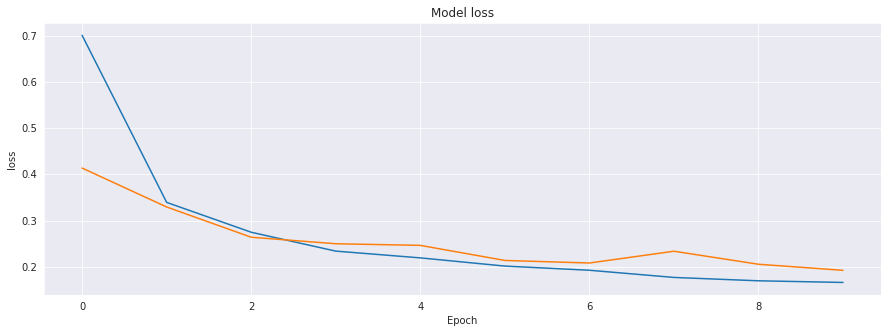

In [38]:
plt.figure(figsize=(15,5))
plt.plot(history_mobilenet_v2.history['loss'])
plt.plot(history_mobilenet_v2.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

## EfficientNet

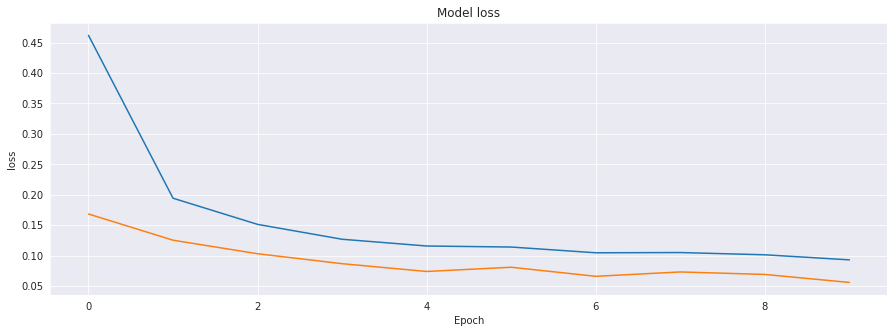

In [51]:
plt.figure(figsize=(15,5))
plt.plot(history_efficientNet.history['loss'])
plt.plot(history_efficientNet.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

## Custom model

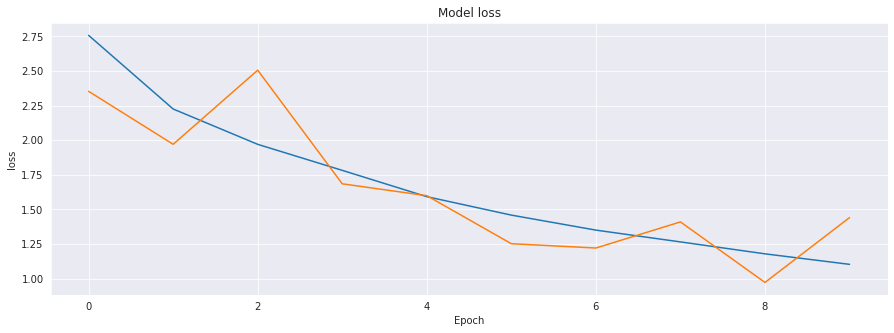

In [99]:
plt.figure(figsize=(15,5))
plt.plot(history_custom_model.history['loss'])
plt.plot(history_custom_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

# Plot Accuracy

## MobileNetV2

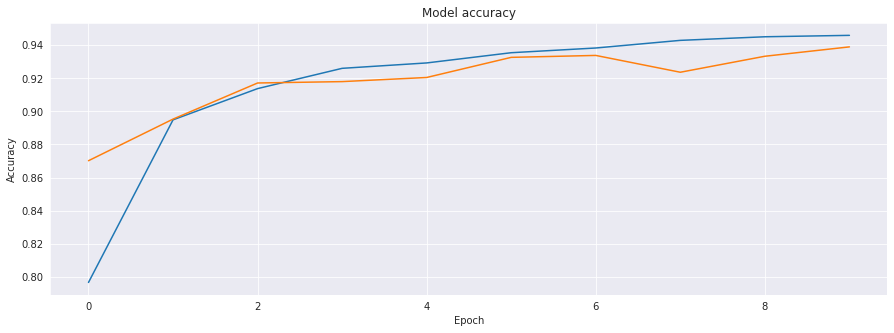

In [39]:
plt.figure(figsize=(15,5))
plt.plot(history_mobilenet_v2.history['accuracy'])
plt.plot(history_mobilenet_v2.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

## EfficientNet

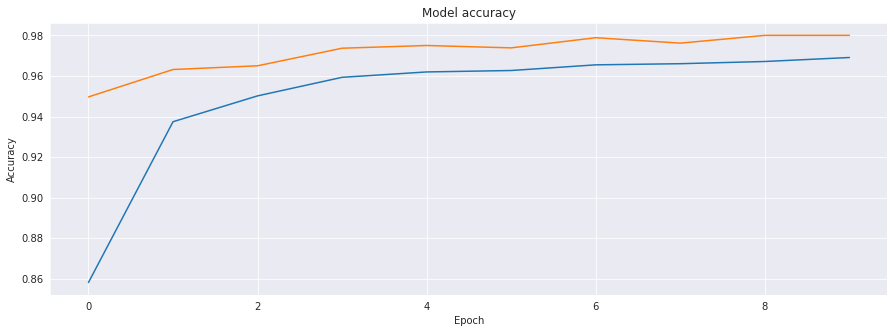

In [52]:
plt.figure(figsize=(15,5))
plt.plot(history_efficientNet.history['accuracy'])
plt.plot(history_efficientNet.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

## Custom model

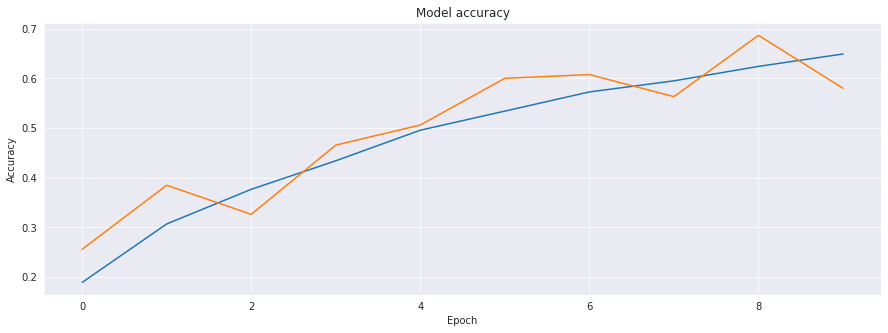

In [100]:
plt.figure(figsize=(15,5))
plt.plot(history_custom_model.history['accuracy'])
plt.plot(history_custom_model.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

## Model Save

In [40]:
model_mobilenetV2.save('./model_mobilenetV2.h5')

/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.

  


In [53]:
model_efficientNet.save('./model_efficientNet.h5')

In [101]:
custom_model.save('./custom_model.h5')

# Model load

In [12]:
from keras.models import load_model

custom_model = load_model('../input/custom-model/custom_model.h5')

2022-09-14 17:48:18.061865: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-14 17:48:18.255660: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-14 17:48:18.256469: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-14 17:48:18.258370: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

**Train for more 10 epochs to see if we could get better results:**

In [13]:
history_custom_model = custom_model.fit(
      train_generator_custom_model,
     validation_data=val_generator_custom_model,
      epochs=10,
      verbose=2)

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


2022-09-14 17:48:33.310384: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-09-14 17:48:36.050135: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005
/opt/conda/lib/python3.7/site-packages/PIL/Image.py:993: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
1063/1063 - 837s - loss: 1.0492 - accuracy: 0.6609 - val_loss: 1.0631 - val_accuracy: 0.6702
Epoch 2/10
1063/1063 - 741s - loss: 0.9931 - accuracy: 0.6796 - val_loss: 0.9379 - val_accuracy: 0.7113
Epoch 3/10
1063/1063 - 738s - loss: 0.9542 - accuracy: 0.6929 - val_loss: 0.9561 - val_accuracy: 0.7007
Epoch 4/10
1063/1063 - 734s - loss: 0.9233 - accuracy: 0.7039 - val_loss: 1.0365 - val_accuracy: 0.6795
Epoch 5/10
1063/1063 - 733s - loss: 0.8694 - accuracy: 0.7202 - val_loss: 0.5194 - val_accuracy: 0.8357
Epoch 6/10
1063/1063 - 737s - loss: 0.8518 - accuracy: 0.7257 - val_loss: 0.5747 - val_accuracy: 0.8158
Epoch 7/10
1063/1063 - 729s - loss: 0.7997 -

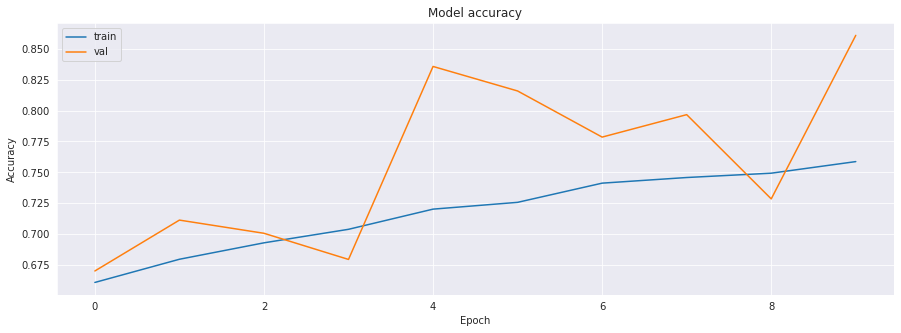

In [16]:
plt.figure(figsize=(15,5))
plt.plot(history_custom_model.history['accuracy'])
plt.plot(history_custom_model.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

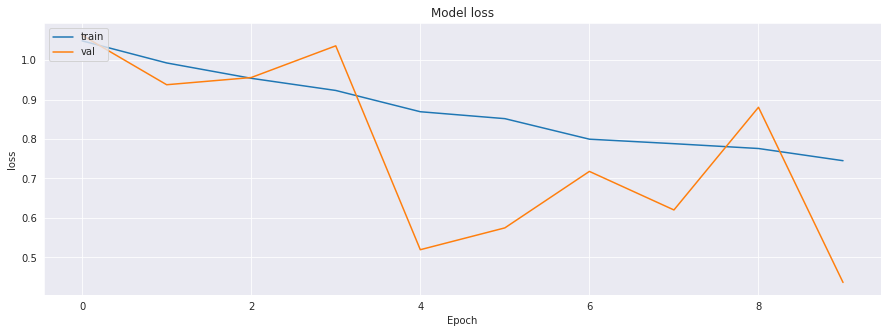

In [37]:
plt.figure(figsize=(15,5))
plt.plot(history_custom_model.history['loss'])
plt.plot(history_custom_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [17]:
custom_model.save('./custom_model_20.h5')

# Confusion matrix

## EfficientNet

In [23]:
from sklearn.metrics import confusion_matrix

def get_confusion_matrix(data_path, N):
    print("Generating confusion matrix", N)
    predictions = []
    targets = []
    i = 0
    n_images = 0
    for x, y in datagen.flow_from_directory(
        data_path,
        target_size=[224,224],
        shuffle=False,
        batch_size=32):
        i += 1
        n_images += len(y)
        if i % 50 == 0:
            print(f'{n_images} images processed.')
        p = model.predict(x)
        p = np.argmax(p, axis=1)
        y = np.argmax(y, axis=1)
        predictions = np.concatenate((predictions, p))
        targets = np.concatenate((targets, y))
        if len(targets) >= N:
            break

    cm = confusion_matrix(targets, predictions)
    return cm

In [54]:
cm = get_confusion_matrix('../input/fish-species/Species/Training_Set', len(train_df))
print(cm)

Generating confusion matrix 34000

Found 34000 images belonging to 20 classes.

1600 images processed.


/opt/conda/lib/python3.7/site-packages/PIL/Image.py:993: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images

  "Palette images with Transparency expressed in bytes should be "


3200 images processed.

4800 images processed.

6400 images processed.

8000 images processed.

9600 images processed.

11200 images processed.

12800 images processed.

14400 images processed.

16000 images processed.

17600 images processed.

19200 images processed.

20800 images processed.

22400 images processed.

24000 images processed.

25600 images processed.

27200 images processed.

28800 images processed.

30400 images processed.

32000 images processed.

33600 images processed.

[[1596    0    0   13    0    6    1    4    3   17    6   24    6    4

     1    0    1    0    2   16]

 [   1 1463   11  102    0    3    3    3    2   26   13    5    2    7

    11    5   22    3    9    9]

 [   1   37 1442   18    6    1    1    0    1   11   19    3   17   46

    20    0   29   23   20    5]

 [   8   34   11 1400    0    2    1    1    0   95   39    4   61    9

    17    4    3    0    7    4]

 [   0   52   27   23 1335    0    8    1    2   40   64   15    7   17

    

In [24]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):

    plt.figure(figsize=(30, 30))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], 'd'),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

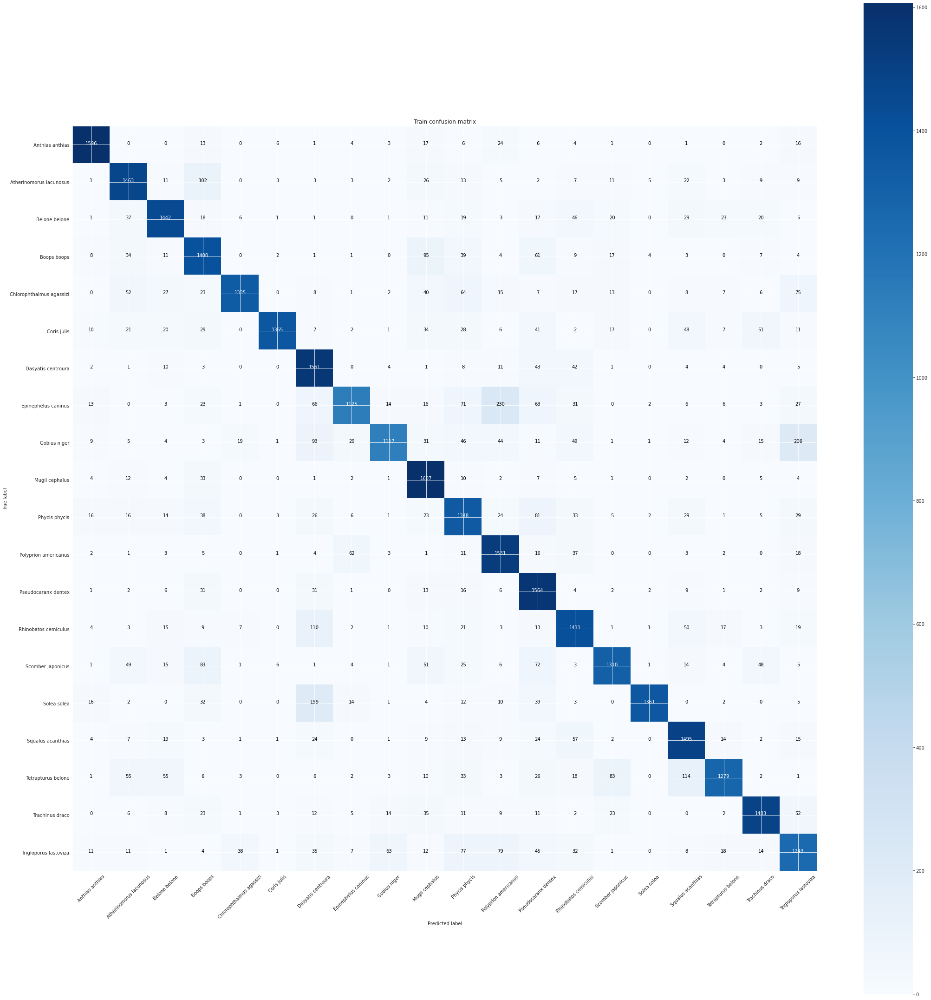

In [60]:
plot_confusion_matrix(cm, labels, title='Train confusion matrix')

## Custom model

In [18]:
model = load_model('./custom_model_20.h5')

Generating confusion matrix 34000
Found 34000 images belonging to 20 classes.
1600 images processed.


/opt/conda/lib/python3.7/site-packages/PIL/Image.py:993: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


3200 images processed.
4800 images processed.
6400 images processed.
8000 images processed.
9600 images processed.
11200 images processed.
12800 images processed.
14400 images processed.
16000 images processed.
17600 images processed.
19200 images processed.
20800 images processed.
22400 images processed.
24000 images processed.
25600 images processed.
27200 images processed.
28800 images processed.
30400 images processed.
32000 images processed.
33600 images processed.


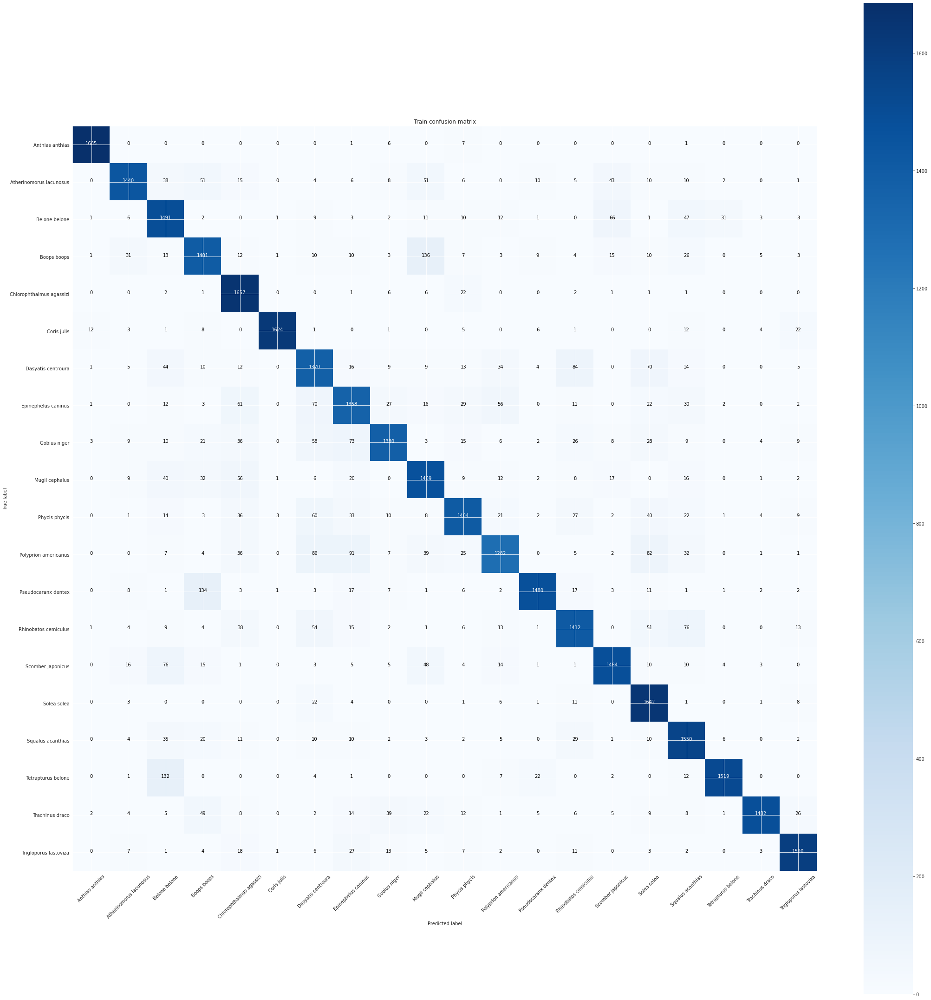

In [29]:
cm = get_confusion_matrix('../input/fish-species/Species/Training_Set', len(train_df))
plot_confusion_matrix(cm, labels, title='Train confusion matrix')